In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy.stats as st
import cna
import pp, pf
plt.style.use('../pp.mplstyle')
np.random.seed(0) # for reproducibility

/PHShome/yr073/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


## read data

In [5]:
print('reading')
mrna = cna.read(pf.tbru_h5ad + 'harmmrna.h5ad')
prot = cna.read(pf.tbru_h5ad + 'harmprot.h5ad')
cca = cna.read(pf.tbru_h5ad + 'harmcca20.h5ad')
mrna_noharm = cna.read(pf.tbru_h5ad + '/mrna.h5ad')

for d in [mrna, prot, cca, mrna_noharm]:
    print('processing...')
    d.obs_to_sample(['batch', 'nUMI', 'percent_mito'])
    cna.tl.nam(d, batches=d.samplem.batch, covs=d.samplem[['nUMI','percent_mito']], force_recompute=True)
    sc.tl.pca(d)

reading
processing...
qcd NAM not found; computing and saving
	taking step 1
	median kurtosis: 96.45571363398902
	taking step 2
	median kurtosis: 66.11929593184762
	taking step 3
	median kurtosis: 39.18345633687962
	taking step 4
	median kurtosis: 25.279649521369095
	taking step 5
	median kurtosis: 17.538748734387784
	taking step 6
	median kurtosis: 13.218013844769336
	taking step 7
	median kurtosis: 10.665356323599964
stopping after 7 steps
throwing out neighborhoods with batch kurtosis >= 8.667603813822101
keeping 393998 neighborhoods
covariate-adjusted NAM not found; computing and saving
	with ridge 100000.0 median batch kurtosis =  3.61557420585108
computing SVD


In [3]:
# read in innateness scores
import rpy2.robjects as robjects
from rpy2.robjects import pandas2ri
pandas2ri.activate()
readRDS = robjects.r['readRDS']

innateness = readRDS(pf.tbru + 'aparna_innateness_01.12.rds')

cellmeta = readRDS(pf.tbru + 'aparna_cell_meta.rds')
cellmeta = cellmeta[cellmeta.memTgate==1]
cellmeta.set_index('cell_id', drop=True, inplace=True)

cellmeta['innateness'] = innateness
cca.obs['innateness'] = cellmeta.innateness
cca.obs.innateness -= cca.obs.innateness.mean()

## make figure

In [33]:
f, axs = plt.subplots(2, 4, figsize=(6,3))

# compare standard PC1 across modalities
ax = axs[0,0]
for i, (d, l, c) in enumerate([(mrna, 'mRNA', 'C0'), (prot, 'protein', 'C1')]):
    d.obs['PC1'] = d.obsm['X_pca'][:,0]
    cca.obs['PC1'] = cca.obsm['X_pca'][:,0]
    x, y = cca.obs.groupby(by='id').PC1.aggregate(np.mean), d.obs.groupby(by='id').PC1.aggregate(np.mean)
    x = x/x.std(); y = y/y.std()
    ax.scatter(x, y, alpha=0.5, s=2, color=c, label=l)
    ax.text(0.05, 0.85-i/10, '$r^2 = {:.2f}$'.format(np.corrcoef(x,y)[0,1]**2),
            transform=ax.transAxes,
            fontsize=6,
            color=c)
    ax.set_ylabel('PC1 (mRNA/protein)')
    ax.set_xlabel('PC1 (CCA)')
    ax.set_xticks([]); ax.set_yticks([])
    ax.legend(loc=4)
ax.set_title('standard PCs', fontsize=8)

# compare NAM PC1 across modalities
ax = axs[0,1]
for i, (d, l, c) in enumerate([(mrna, 'mRNA', 'C0'), (prot, 'protein', 'C1')]):
    x, y = cca.uns['NAM_sampleXpc'].PC1, d.uns['NAM_sampleXpc'].PC1
    ax.scatter(x, y, alpha=0.5, s=2, color=c, label=l)
    ax.set_ylabel('PC1 (mRNA/protein)')
    ax.set_xlabel('PC1 (CCA)')
    ax.set_xticks([]); ax.set_yticks([])
    ax.text(0.05, 0.85-i/10, '$r^2 = {:.2f}$'.format(np.corrcoef(x,y)[0,1]**2),
            transform=ax.transAxes,
            fontsize=6,
            color=c)
    ax.legend(loc=4)
ax.set_title('NAM PCs', fontsize=8)

#UMAPs of NAM PC1
umap = cca.obsm['X_umap'][cca.uns['keptcells']]
for ax, c, l in [(axs[0,2], -cca.uns['NAM_nbhdXpc'].PC1, 'NAM PC1'), (axs[0,3], cca.obs.innateness[cca.uns['keptcells']], 'innateness')]:
    ax.axis('off')
    pp.scatter_random(*umap.T, alpha=0.05, c=c, cmap='seismic', ax=ax)
    ax.set_title(l, fontsize=8)

# variance explained by top PCs
ax = axs[1,0]
for i, (d, l, c) in enumerate([(mrna, 'mRNA', 'C0'), (prot, 'protein', 'C1'), (cca, 'CCA', 'C2')]):
    y = np.cumsum(np.concatenate([[0], d.uns['NAM_varexp']]))
    k = np.where(y >= 0.5)[0][0]
    ax.plot(y, color=c, label=l, alpha=0.8)
    ax.axhline(y=0.5, color='gray', linestyle='--', alpha=0.5)
    ax.set_xlabel('# PCs')
    ax.set_ylabel('% variance explained')
    ax.set_yticks([0,1])
    ax.set_xticks([0,len(y)-1])
    ax.legend(loc=4, handletextpad=0.7)
    ax.text(0.62, 0.78-i/10, '{} PCs'.format(k),
           transform=ax.transAxes,
           fontsize=6,
           color=c)

# sex association scatter plot
U, V = mrna_noharm.uns['NAM_sampleXpc'], mrna_noharm.uns['NAM_nbhdXpc']
i, j = 'PC2', 'PC4'

ax1 = axs[1,1]
male = mrna_noharm.samplem.Sex_M.astype(bool)
ax1.scatter(U[i][male], U[j][male], alpha=0.7, s=2, label='male', color='blue')
ax1.scatter(U[i][~male], U[j][~male], alpha=0.7, s=2, label='female', color='purple')
ax1.legend()
ax1.set_xticks([]); ax1.set_yticks([])
ax1.set_xlabel('NAM {} (r={:.2f})'.format(i, np.corrcoef(U[i], mrna_noharm.samplem.Sex_M)[0,1]))
ax1.set_ylabel('NAM {} (r={:.2f})'.format(j, np.corrcoef(U[j], mrna_noharm.samplem.Sex_M)[0,1]))

# sex association neighborhood loadings
umap = mrna_noharm.obsm['X_umap'][mrna_noharm.uns['keptcells']]
for ax, c in (axs[1,2], V[i]), (axs[1,3], V[j]):
    ax.axis('off')
    pp.scatter_random(*umap.T, alpha=0.05, c=c, cmap='seismic', ax=ax)
    ax.set_title('NAM ' + c.name + ' (mRNA)', fontsize=8)

plt.tight_layout()
plt.savefig('../_figs/rawmainfig.tbru.unsupervised.pdf')

## main text numbers

In [33]:
# variance explained by first NAM PC for each modality
for d in [mrna, prot, cca]:
    print(d.uns['NAM_varexp'][0])

0.23074752735913887
0.15241683973461584
0.24262001532194377


In [82]:
# correlation of NAM PC1 to innateness
np.corrcoef(-cca.uns['NAM_nbhdXpc'].PC1, cca.obs.innateness[cca.uns['keptcells']])[0,1]

0.8120593995627992

## supplementary season of blood draw analysis

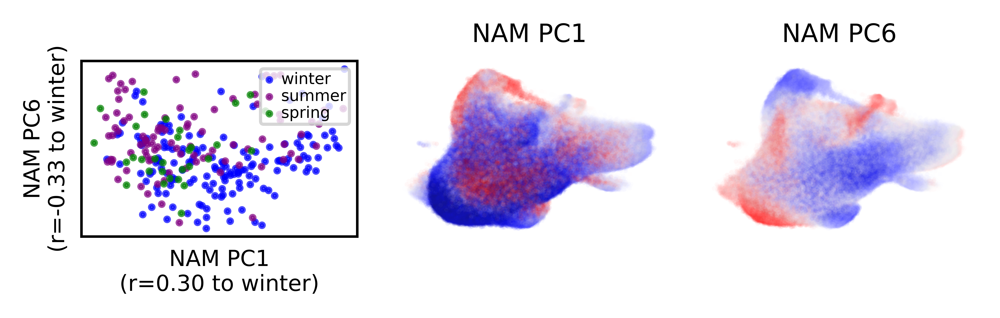

In [24]:
f, axs = plt.subplots(1,3, figsize=(4.5,1.5))

U, V = mrna_noharm.uns['NAM_sampleXpc'], mrna_noharm.uns['NAM_nbhdXpc']
i, j = 'PC1', 'PC6'

ax1 = axs[0]
winter = mrna_noharm.samplem.season_Winter.astype(bool)
summer = mrna_noharm.samplem.season_Summer.astype(bool)
spring = mrna_noharm.samplem.season_Spring.astype(bool)
ax1.scatter(U[i][winter], U[j][winter], alpha=0.7, s=2, label='winter', color='blue')
ax1.scatter(U[i][summer], U[j][summer], alpha=0.7, s=2, label='summer', color='purple')
ax1.scatter(U[i][spring], U[j][spring], alpha=0.7, s=2, label='spring', color='green')
ax1.legend(loc='upper right')
ax1.set_xticks([]); ax1.set_yticks([])
ax1.set_xlabel('NAM {}\n(r={:.2f} to winter)'.format(i, np.corrcoef(U[i], mrna_noharm.samplem.season_Winter)[0,1]))
ax1.set_ylabel('NAM {}\n(r={:.2f} to winter)'.format(j, np.corrcoef(U[j], mrna_noharm.samplem.season_Winter)[0,1]))

umap = mrna_noharm.obsm['X_umap'][mrna_noharm.uns['keptcells']]
for ax, c in (axs[1], V[i]), (axs[2], V[j]):
    ax.axis('off')
    pp.scatter_random(*umap.T, alpha=0.05, c=c, cmap='seismic', vmin=-max(np.abs(c)), vmax=max(np.abs(c)), ax=ax)
    ax.set_title('NAM ' + c.name, fontsize=8)

plt.tight_layout()
plt.savefig('../_figs/suppfig.tbru.unsupervised_season.pdf')

### Get marker genes for sex-correlated PCs

In [27]:
d = mrna_noharm
X = d.X[d.uns['keptcells']]

for c in [V.PC1, V.PC6]:
    print(c.name)
    # define 20% most positive and negative cells along PC
    c_pos = c.copy(); c_pos[c_pos < np.percentile(c_pos, 20)] = 0
    c_neg = -c.copy(); c_neg[c_neg < np.percentile(c_neg, 20)] = 0
    
    # compute correlations to gene expression
    corrs_pos = (X - X.mean(axis=0)).T.dot(c_pos - c_pos.mean()) / c_pos.std() / X.std(axis=0) / len(c_pos)
    corrs_neg = (X - X.mean(axis=0)).T.dot(c_neg - c_neg.mean()) / c_neg.std() / X.std(axis=0) / len(c_neg)
    df_pos = pd.DataFrame(index=d.var.index, data={'corr':corrs_pos})
    df_neg = pd.DataFrame(index=d.var.index, data={'corr':corrs_neg})
    
    # print results
    print('top marker genes for positive cells along PC')
    print(df_pos.sort_values(by='corr', ascending=False)[:10])
    
    print('top marker genes for negative cells along PC')
    print(df_neg.sort_values(by='corr', ascending=False)[:10])

PC1
top marker genes for positive cells along PC
             corr
TNFAIP3  0.324608
ZFP36    0.289440
NR4A2    0.256797
BTG1     0.245447
EIF1     0.245254
JUNB     0.231361
JUND     0.228763
NFKBIA   0.219784
PIM3     0.215942
FOS      0.215403
top marker genes for negative cells along PC
           corr
LTB    0.329472
RPL13  0.306307
TPT1   0.302679
RPL32  0.299564
RPS6   0.293559
RPS18  0.291411
RPL9   0.288302
RPS3A  0.288292
RPS12  0.287311
RPS8   0.285763
PC6
top marker genes for positive cells along PC
           corr
LIMS1  0.221326
PASK   0.194140
LTB    0.186233
RPL37  0.182833
RPS8   0.177137
CCR7   0.173860
RPS4X  0.172993
RPL22  0.171030
RPS6   0.169244
TPT1   0.167633
top marker genes for negative cells along PC
             corr
GZMK     0.295034
RPS4Y1   0.237507
ANXA1    0.190639
LYAR     0.184463
DUSP2    0.182179
ZFP36L2  0.182085
CCL5     0.181451
DDX3Y    0.169478
IL7R     0.158349
TNFAIP3  0.154023
